### The University of Melbourne, School of Computing and Information Systems
# COMP90086 Computer Vision, 2022 Semester 2

## Assignment 1

**Student Name:**    `Jiahao Chen`

**Student ID:**     `1118749`

This iPython notebook is a template which you should use for your Assignment 3 submission. This file should be submitted at the **Assignment 3: Code** link on the LMS, along with any images needed to run your code.

In addition to this file, you should submit a writren report explaining your results at the **Assignment 3: Report** link on the LMS. Please see the assignment specification for details on what must be included in the report for each question.

*Adding proper comments to your code is MANDATORY.*

In [1]:
import os
import numpy as np
import cv2
import glob
import random
from matplotlib import pyplot as plt

### 1. Load images and compute correspondences


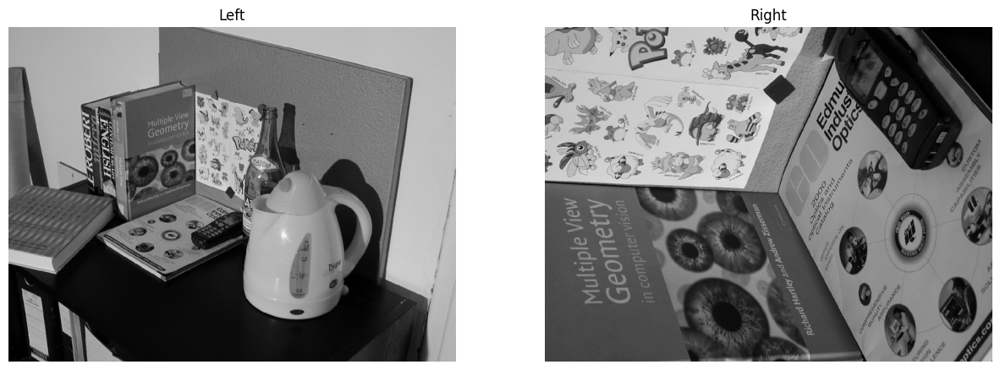

In [2]:
# Get paths of all pairs of images
left_images = glob.glob('./kusvod2/*A.png')
right_images = glob.glob('./kusvod2/*B.png')

# Take the first pair of images as example
# Load left and right images as grayscale
t_imgL = cv2.imread(left_images[0], cv2.IMREAD_GRAYSCALE)
t_imgR = cv2.imread(right_images[0], cv2.IMREAD_GRAYSCALE)

# Display example images
def display_image_pair(imgL, imgR):
    plt.subplots(figsize=(15, 15)) 

    plt.subplot(1,2,1)
    plt.imshow(imgL, cmap='gray')  
    plt.title('Left')
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(imgR, cmap='gray')  
    plt.title('Right')
    plt.axis('off')

    plt.show() 
    
display_image_pair(t_imgL, t_imgR)

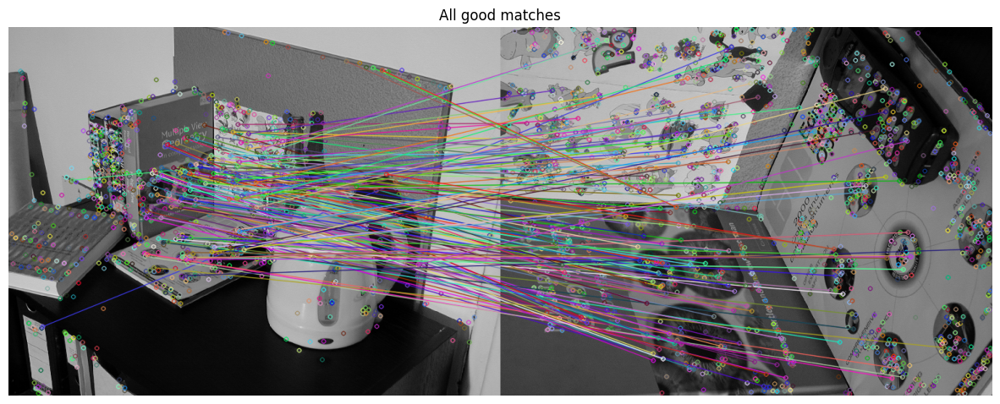


Number of good matches between two images:  157


In [3]:
# Use SIFT and FLANN to compute correspondences
def compute_matches(imgL, imgR):
    # Compute SIFT keypoints and descriptors
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(imgL, None)
    kp2, des2 = sift.detectAndCompute(imgR, None)

    # FLANN parameters and initialize
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Matching descriptor using KNN algorithm
    matches = flann.knnMatch(des1, des2, k=2)

    # Apply ratio test
    ptsL = []
    ptsR = []

    # Create a mask to draw all good matches
    matchesMask = []

    for i,(m,n) in enumerate(matches):
        if m.distance < 0.7 * n.distance:
            ptsL.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
            ptsR.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])
            matchesMask.append([1,0])
        else:
            matchesMask.append([0,0])

    ptsL = np.int32(ptsL)
    ptsR = np.int32(ptsR)

    # Draw all good matches
    draw_params = dict(matchesMask = matchesMask, flags = cv2.DrawMatchesFlags_DEFAULT)
    good_matches = cv2.drawMatchesKnn(imgL, kp1, imgR, kp2, matches, None, **draw_params)

    plt.figure(figsize=(15, 15))
    plt.imshow(good_matches)
    plt.title('All good matches')
    plt.axis('off')
    plt.show()

    # Print total number of good matches between two images
    print("\nNumber of good matches between two images: ", len(ptsL))
    
    return ptsL, ptsR

t_ptsL, t_ptsR = compute_matches(t_imgL, t_imgR)

### 2. Compute the Fundamental Matrix F using the 8 point algorithm

In [4]:
# a. Shift and scale the pixel coordinates

t_width = len(t_imgL[0])
t_height = len(t_imgL)

# Shift the center to the origin
def shift(pts, width, height):
    pts_matrix = np.matrix(pts).getT()
    norm_matrix = np.matrix([[1, 0, -width / 2],
                             [0, 1, -height / 2],
                             [0, 0, 1]
                            ])
    norm_pts = np.matmul(norm_matrix, pts_matrix).getT()
    return norm_matrix, norm_pts.tolist()

t_normL, t_ptsnL = shift(t_ptsL, t_width, t_height)
t_normR, t_ptsnR = shift(t_ptsR, t_width, t_height)

print("Transform matrix:")
print(t_normL)


# Get mean standard deviation of a set of points
# def points_std(pts, centroid):
#     sum_distance = 0
#     for point in pts:
#         sum_distance += np.square(point[0] - centroid[0]) + np.square(point[1] - centroid[1])
#     return np.sqrt(sum_distance / len(pts))

# Normalise the set of points by shift the centroid to the origin
# def normalise(pts):
#     centroid = np.mean(pts, axis=0)
#     std = points_std(pts, centroid)
#     pts_matrix = np.matrix(pts).getT()
#     # print(pts_matrix.shape)
#     sqrt2 = np.sqrt(2)
#     norm_matrix = np.matrix([[sqrt2 / std, 0, -sqrt2 * centroid[0] / std],
#                              [0, sqrt2 / std, -sqrt2 * centroid[1] / std],
#                              [0, 0, 1]
#                             ])
#     norm_pts = np.matmul(norm_matrix, pts_matrix).getT()
#     return norm_matrix, norm_pts.tolist(), std

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -288.]
 [   0.    0.    1.]]


In [5]:
# b. Compute the design matrix from sets of at least 8 points
def get_design_matrix(ptsLeft, ptsRight, index_range):
    # Randomly choose 8 points
    sample_index = random.sample(index_range, 8)
    design_list = []
    for i in sample_index:
        pl = ptsLeft[i]
        pr = ptsRight[i]
        ul = pl[0]
        vl = pl[1]
        ur = pr[0]
        vr = pr[1]
        design_list.append([ul*ur, ul*vr, ul, vl*ur, vl*vr, vl, ur, vr, 1])
    return np.matrix(design_list), sample_index

In [6]:
# c. Perform an SVD of the design matrix to find its null space
# d. Compose the draft fundamental matrix F
# e. Perform an SVD of the draft fundamental matrix, 
#    set the smallest singular value to zero and reassemble so that F now has determinant = 0
def get_F(mat):
    null_space = np.linalg.svd(mat)[-1][-1]
    draft = np.reshape(null_space, (3, 3))
    u, s, vh = np.linalg.svd(draft)
    s = np.matrix([[s[0], 0, 0],
                   [0, s[1], 0],
                   [0, 0, 0]
                  ])
    return np.matmul(np.matmul(u, s), vh)

In [7]:
# f. Calculate which correspondences are inliers and which are outliers using this F.

def pt_line_dist(pt, line):
    x = np.abs(line[0] * pt[0] + line[1] * pt[1] + line[2])
    y = np.sqrt(np.square(line[0]) + np.square(line[1]))
    return x / y

def find_inliers(ptsLeft, ptsRight, f_mat):
    inliers_index = []
    for i in range(len(ptsLeft)):
        ptL = np.matrix(ptsLeft[i])
        ptR = np.matrix(ptsRight[i]).getT()
        
        lineR = np.matmul(ptL, f_mat).tolist()[0]
        lineL = np.matmul(f_mat, ptR).getT().tolist()[0]

        left_error = pt_line_dist(ptL.tolist()[0], lineL)
        right_error = pt_line_dist(ptR.getT().tolist()[0], lineR)

        if (left_error < 2 and right_error < 2):
            inliers_index.append(i)
            
    return inliers_index

In [8]:
# g. Wrap steps b-f in a RANSAC loop

# Determine value of k
def get_enough_k(inlier_rate):
    return np.log(1 - 0.99) / np.log(1 - np.power(inlier_rate, 8))

def ransac_8point(ptsLeft, ptsRight):
    
    k = round(get_enough_k(0.5))
    print(f"Run at least {k} times to have a probability over 99% of finding 8 inliers")
    best_inliers = []
    best_f = 0

    while (k >= 0):
        design, index = get_design_matrix(ptsLeft, ptsRight, range(len(ptsLeft)))
        f_mat = get_F(design)
        inliers = find_inliers(ptsLeft, ptsRight, f_mat)
        if (len(inliers) > len(best_inliers)):
            best_inliers = inliers
            best_f = f_mat
            inlier_rate = len(inliers) / len(ptsRight)
        k -= 1
    
    return best_f, best_inliers

t_best_f, t_best_inliers = ransac_8point(t_ptsnL, t_ptsnR)
print("Best F for shifted images:")
print(t_best_f)
print(f"Number of inliers: {len(t_best_inliers)}")

Run at least 1177 times to have a probability over 99% of finding 8 inliers
Best F for shifted images:
[[ 1.19183874e-04  4.94910338e-07  2.02357344e-02]
 [ 2.49729916e-06  1.18258681e-04 -4.39142729e-02]
 [ 2.51703256e-02  8.83904837e-03  9.98474010e-01]]
Number of inliers: 123


In [9]:
# h. Re-estimate F using all the inliers
# i. Compute F in terms of the original pixel coordinates
def get_final_F(inliers, normL, normR, ptsLeft, ptsRight):
    design_list = []
    for i in inliers:
        pl = ptsLeft[i]
        pr = ptsRight[i]
        ul = pl[0]
        vl = pl[1]
        ur = pr[0]
        vr = pr[1]
        design_list.append([ul*ur, ul*vr, ul, vl*ur, vl*vr, vl, ur, vr, 1])
    final_design = np.matrix(design_list)
    res = get_F(final_design)
    return np.matmul(np.matmul(normR.getT(), res), normL)

t_final_f = get_final_F(t_best_inliers, t_normL, t_normR, t_ptsnL, t_ptsnR)
print("F in terms of original pixel coordinates:")
print(t_final_f)

F in terms of original pixel coordinates:
[[ 9.90021334e-05  3.18249087e-07 -1.94016430e-02]
 [ 1.96850963e-06  9.81805231e-05 -6.32170392e-02]
 [-1.84697448e-02 -2.03743637e-02  1.66211016e+01]]


In [10]:
# Find inliers in the original images using F
def find_final_inliers(ptsLeft, ptsRight, f_mat):
    inliersL = []
    inliersR = []
    for i in range(len(ptsLeft)):
        ptL = np.matrix(ptsLeft[i])
        ptR = np.matrix(ptsRight[i]).getT()
        
        lineR = np.matmul(ptL, f_mat).tolist()[0]
        lineL = np.matmul(f_mat, ptR).getT().tolist()[0]

        left_error = pt_line_dist(ptL.tolist()[0], lineL)
        right_error = pt_line_dist(ptR.getT().tolist()[0], lineR)

        if (left_error < 2 and right_error < 2):
            inliersL.append([ptL.tolist()[0][0], ptL.tolist()[0][1]])
            inliersR.append([ptR.getT().tolist()[0][0], ptR.getT().tolist()[0][1]])
            
    return inliersL, inliersR

t_ptsiL, t_ptsiR = find_final_inliers(t_ptsL, t_ptsR, t_final_f)
t_ptsiL = np.int32(t_ptsiL)
t_ptsiR = np.int32(t_ptsiR)
print(f"Number of inliers: {len(t_ptsiL)}")

Number of inliers: 129


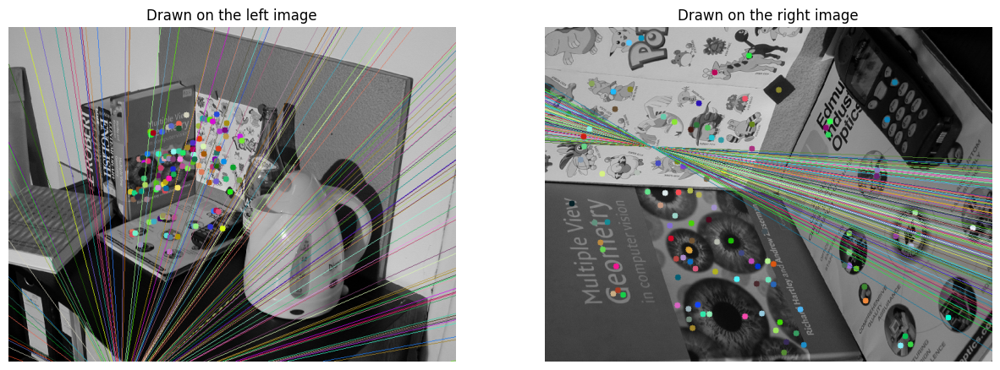

In [11]:
# Create a function to draw epilines over the images
# Epilines corresponding to the points in first image is drawn on second image
def drawlines(img1,img2,lines,pts1,pts2):
    ''' img1 - image on which we draw the epilines for the points in img2
        lines - corresponding epilines '''
    r,c = img1.shape
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)
    for r,pt1,pt2 in zip(lines, pts1, pts2):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv2.line(img1, (x0,y0), (x1,y1), color, 1)
        img1 = cv2.circle(img1, tuple(pt1), 5, color, -1)
        img2 = cv2.circle(img2, tuple(pt2), 5, color, -1)
    return img1,img2


def draw_epilines(ptsLeft, ptsRight, f_mat, imgL, imgR):
    # Find epilines corresponding to points in right image and draw its lines on left image
    linesL = cv2.computeCorrespondEpilines(ptsRight.reshape(-1,1,2), 2, f_mat)
    linesL = linesL.reshape(-1,3)
    img5, img6 = drawlines(imgL, imgR, linesL, ptsLeft, ptsRight)

    # Find epilines corresponding to points in left image and draw its lines on right image
    linesR = cv2.computeCorrespondEpilines(ptsLeft.reshape(-1,1,2), 1, f_mat)
    linesR = linesR.reshape(-1,3)
    img3, img4 = drawlines(imgR, imgL, linesR, ptsRight, ptsLeft)

    # Display the results
    plt.subplots(figsize=(15, 15)) 

    plt.subplot(1,2,1)
    plt.imshow(img5, cmap='gray')  
    plt.title('Drawn on the left image')
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(img3, cmap='gray')  
    plt.title('Drawn on the right image')
    plt.axis('off')

    plt.show()
    
draw_epilines(t_ptsiL, t_ptsiR, t_final_f, t_imgL, t_imgR)

### 3. Randomly sample 10 correspondences and display images, corresponding points and epipolar lines

In [12]:
# Encapsulate all the functions
def display_all(imgL_path, imgR_path):
    # Load image
    imgL = cv2.imread(imgL_path, cv2.IMREAD_GRAYSCALE)
    imgR = cv2.imread(imgR_path, cv2.IMREAD_GRAYSCALE)
    display_image_pair(imgL, imgR)
    
    # Get width and height
    width = len(imgL[0])
    height = len(imgL)
    
    # Use SIFT and FLANN to compute correspondences
    ptsL, ptsR = compute_matches(imgL, imgR)
    
    # Shift and scale the pixel coordinates
    normL, ptsnL = shift(ptsL, width, height)
    normR, ptsnR = shift(ptsR, width, height)
    print("\nTransform matrix:")
    print(normL)
    print()
    
    # 8-point ransac
    best_f, best_inliers = ransac_8point(ptsnL, ptsnR)
    print("\nBest F for shifted images:")
    print(best_f)
    print(f"Number of inliers: {len(best_inliers)}")
    
    # Reestimate and compute F in terms of the original pixel coordinates
    final_f = get_final_F(best_inliers, normL, normR, ptsnL, ptsnR)
    print("\nF in terms of original pixel coordinates:")
    print(final_f)
    
    # Find inliers in the original images using F
    ptsiL, ptsiR = find_final_inliers(ptsL, ptsR, final_f)
    print(f"Number of inliers: {len(ptsiL)}")
    
    # Randomly sample 10 matches and display epipolar lines
    if (len(ptsiL) > 10):
        sample_index = random.sample(range(len(ptsiL)), 10)
        sample_ptsL = []
        sample_ptsR = []
        for i in sample_index:
            sample_ptsL.append(ptsiL[i])
            sample_ptsR.append(ptsiR[i])
        sample_ptsL = np.int32(sample_ptsL)
        sample_ptsR = np.int32(sample_ptsR)
        draw_epilines(sample_ptsL, sample_ptsR, final_f, imgL, imgR)
    elif (len(ptsiL) == 0):
        print("No valid epipolar lines!")
    else:
        ptsiL = np.int32(ptsiL)
        ptsiR = np.int32(ptsiR)
        draw_epilines(ptsiL, ptsiR, final_f, imgL, imgR)





Image Pair 0


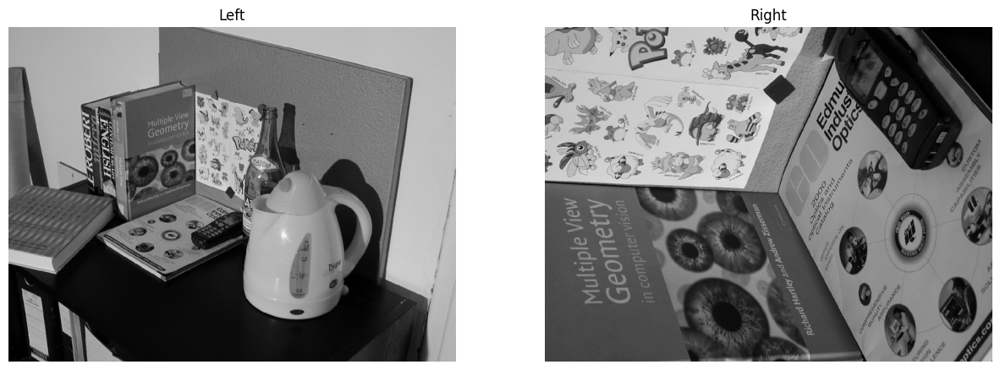

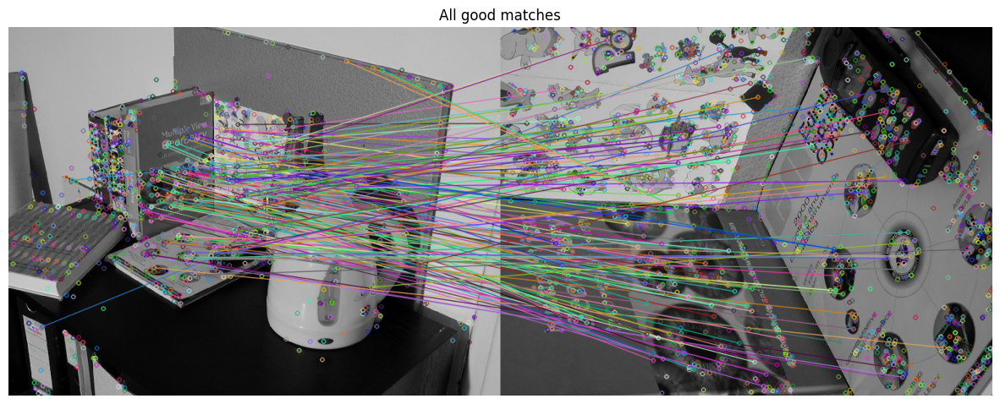


Number of good matches between two images:  158

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -288.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[ 1.02339366e-04  3.48251727e-07  1.83159039e-02]
 [ 1.93945964e-06  1.00931431e-04 -3.33687832e-02]
 [ 2.01264222e-02  7.86037030e-03  9.99041627e-01]]
Number of inliers: 124

F in terms of original pixel coordinates:
[[ 8.59521964e-05 -6.78154812e-08 -1.53017224e-02]
 [ 2.05943243e-06  8.49221189e-05 -5.31180807e-02]
 [-1.67168635e-02 -1.70187098e-02  1.35556135e+01]]
Number of inliers: 110


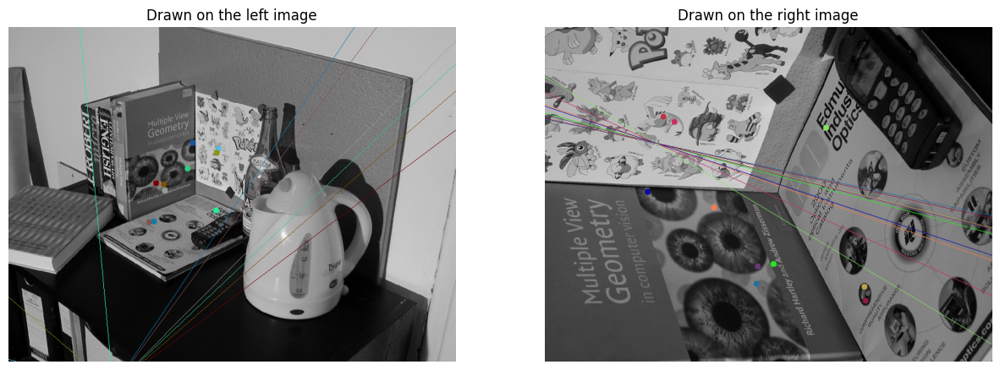





Image Pair 1


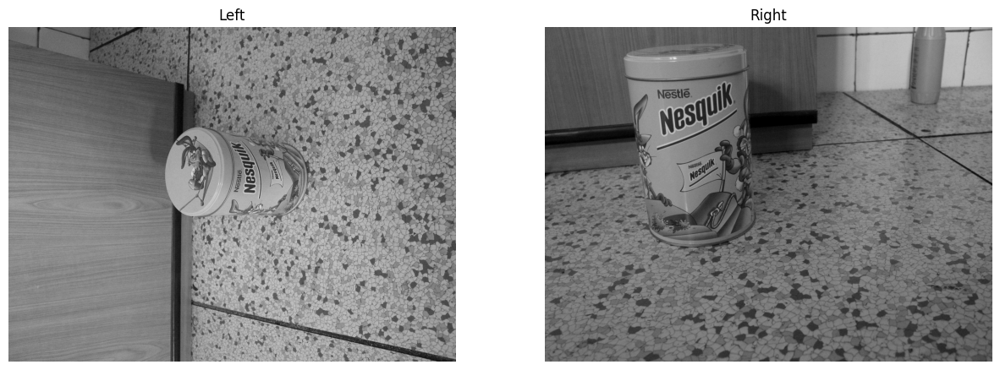

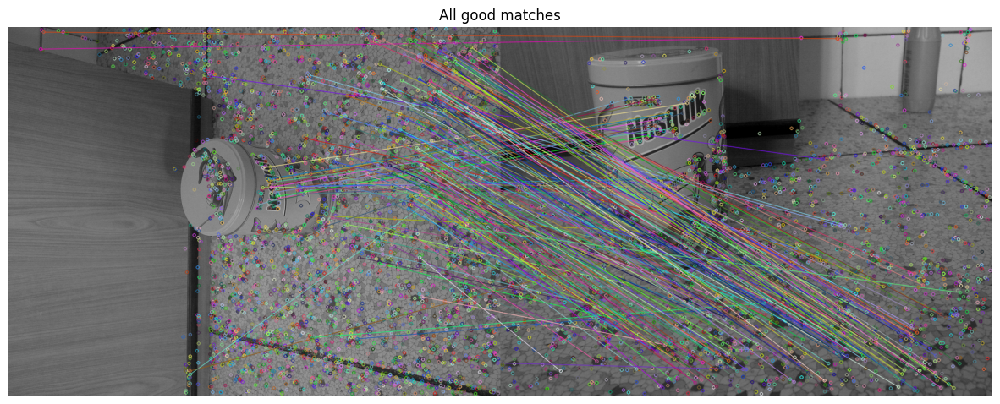


Number of good matches between two images:  186

Transform matrix:
[[   1.    0. -512.]
 [   0.    1. -384.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-3.01139979e-05  2.73653385e-07 -3.83597814e-03]
 [-5.78501914e-06 -5.00177723e-05  5.75761732e-03]
 [ 5.28162967e-03 -2.57039048e-03  9.99958814e-01]]
Number of inliers: 142

F in terms of original pixel coordinates:
[[-1.60256122e-05  7.86393997e-07  6.36926640e-03]
 [-3.02569384e-06 -2.32522177e-05  1.69681147e-02]
 [ 1.45823279e-02  6.54180851e-03 -1.06851032e+01]]
Number of inliers: 123


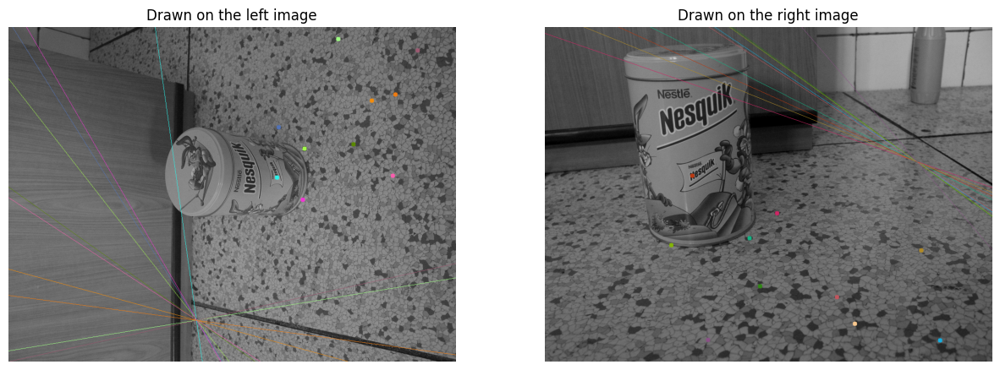





Image Pair 2


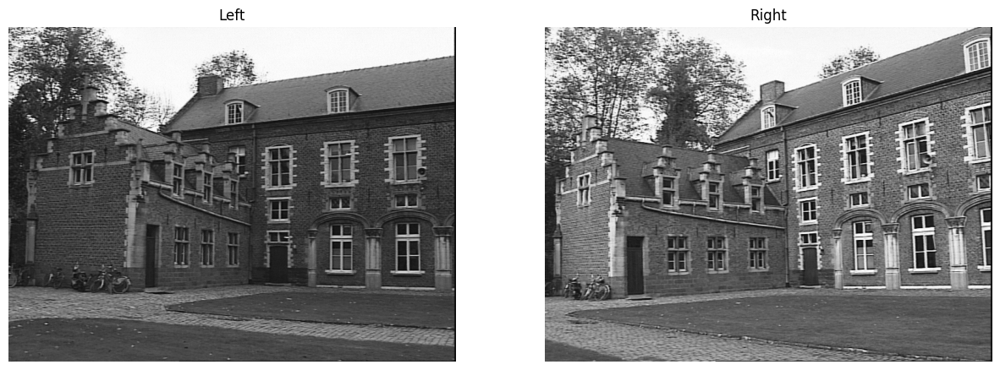

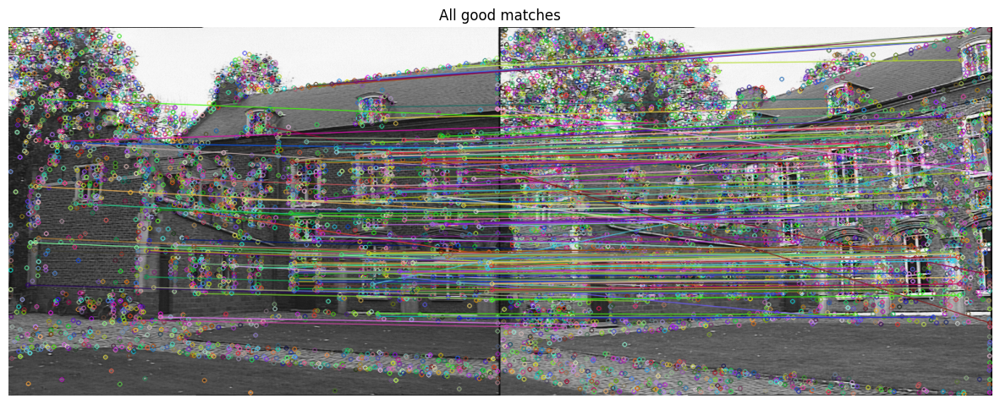


Number of good matches between two images:  186

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -288.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-6.22039664e-07  1.41128873e-05 -5.06131602e-03]
 [ 3.24472082e-05  1.78807903e-06  1.23875313e-01]
 [-5.90609912e-03 -1.24246806e-01  9.84457789e-01]]
Number of inliers: 145

F in terms of original pixel coordinates:
[[ 1.45817479e-07 -2.10776337e-05  1.16019439e-02]
 [-2.32769269e-05  9.74026848e-07 -1.14190076e-01]
 [ 1.18334023e-02  1.31596977e-01 -1.01940384e+01]]
Number of inliers: 145


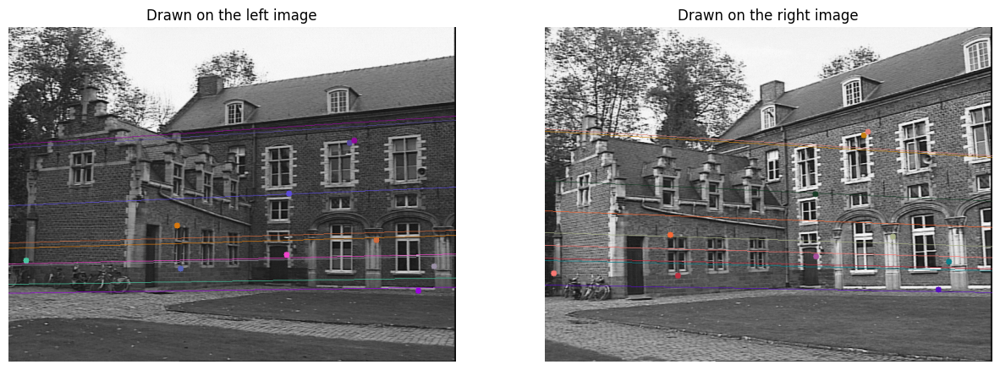





Image Pair 3


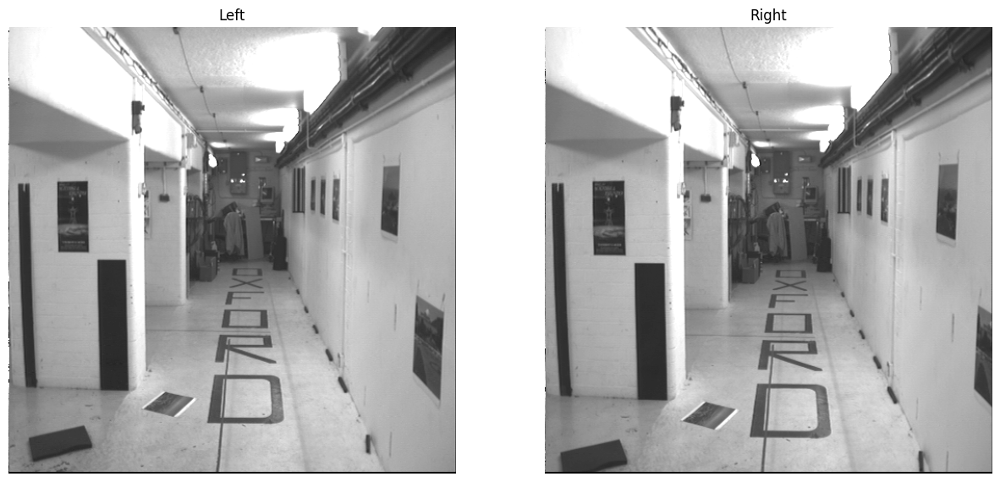

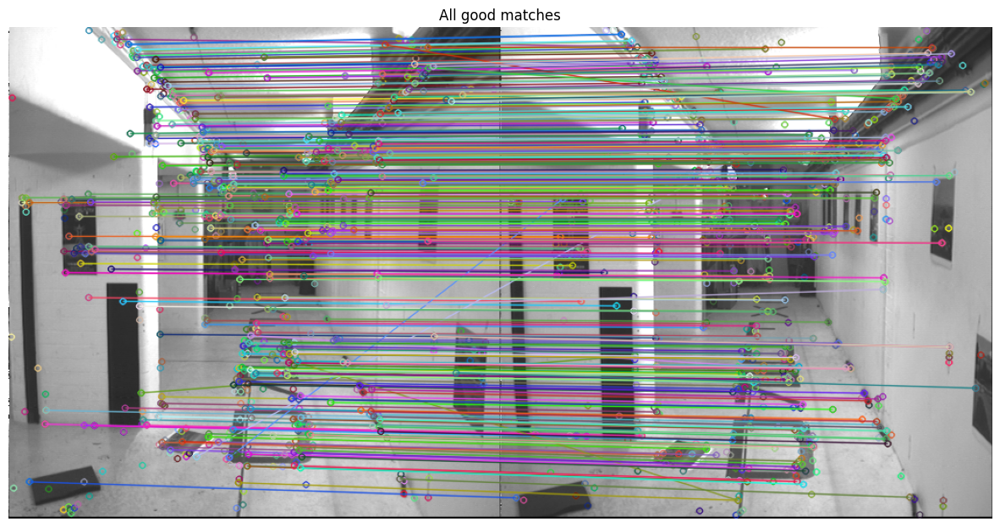


Number of good matches between two images:  397

Transform matrix:
[[   1.    0. -256.]
 [   0.    1. -256.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-1.09737588e-05  3.15053135e-03  1.50746806e-01]
 [-3.13876753e-03 -1.63825086e-06 -7.39717320e-02]
 [-1.52510866e-01  9.51322085e-02  9.69264723e-01]]
Number of inliers: 385

F in terms of original pixel coordinates:
[[ 8.40193662e-07  1.10104983e-03 -1.67903920e-01]
 [-1.09917600e-03 -6.65669652e-07  2.95167025e-01]
 [ 1.69028344e-01 -2.85635986e-01 -1.87503205e+00]]
Number of inliers: 376


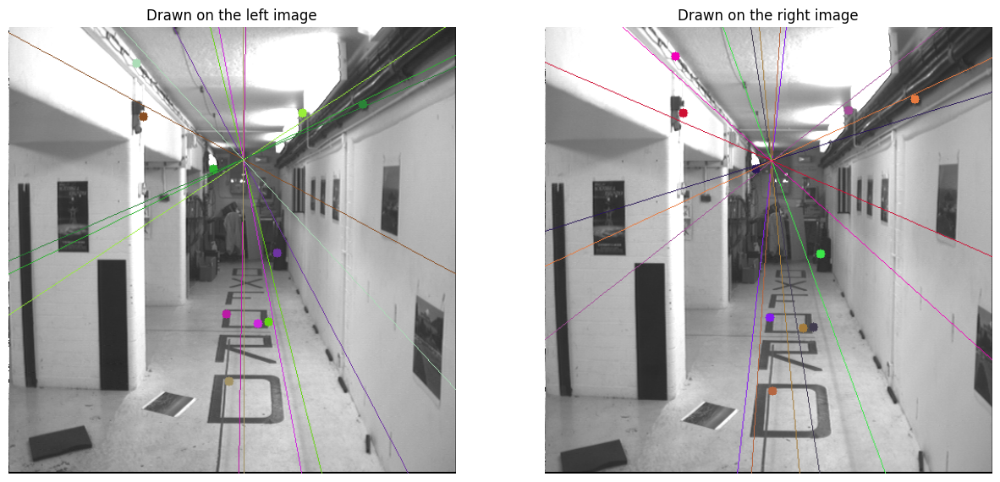





Image Pair 4


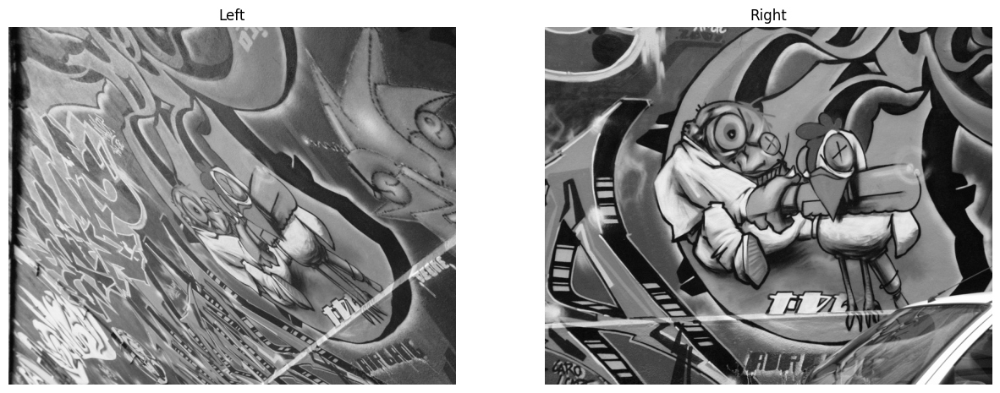

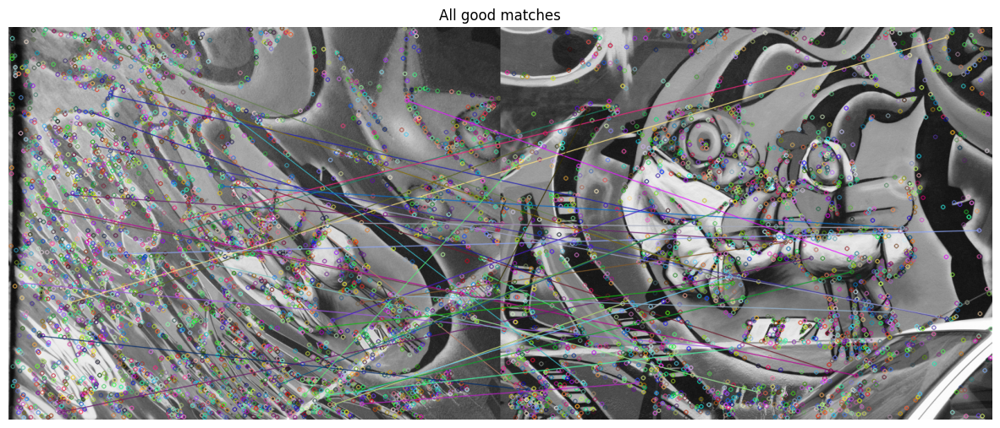


Number of good matches between two images:  40

Transform matrix:
[[   1.    0. -400.]
 [   0.    1. -320.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-3.50690766e-06 -4.35710980e-06  4.60802714e-04]
 [-1.24437702e-06  3.25834803e-05 -5.84010164e-03]
 [-4.44365651e-04 -5.90480215e-03  9.99965307e-01]]
Number of inliers: 10

F in terms of original pixel coordinates:
[[-3.50018958e-06 -4.36232517e-06  3.25837806e-03]
 [-1.24944731e-06  3.25770542e-05 -1.57631998e-02]
 [ 1.35548171e-03 -1.45854735e-02  6.80844372e+00]]
Number of inliers: 10


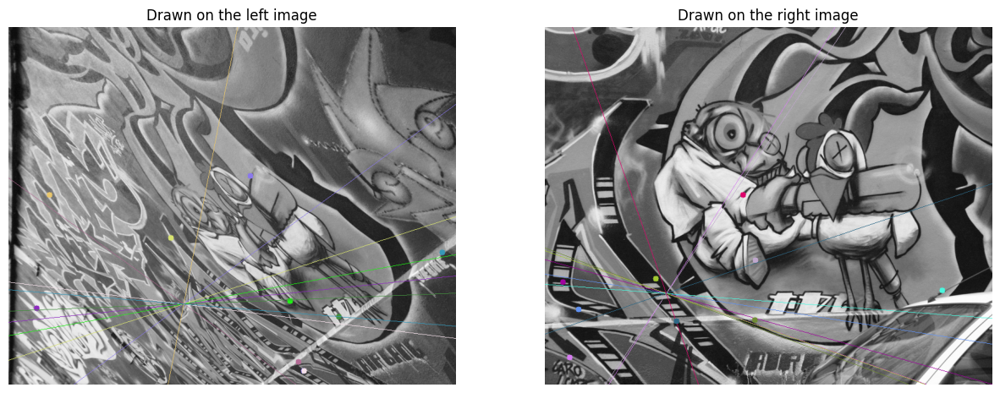





Image Pair 5


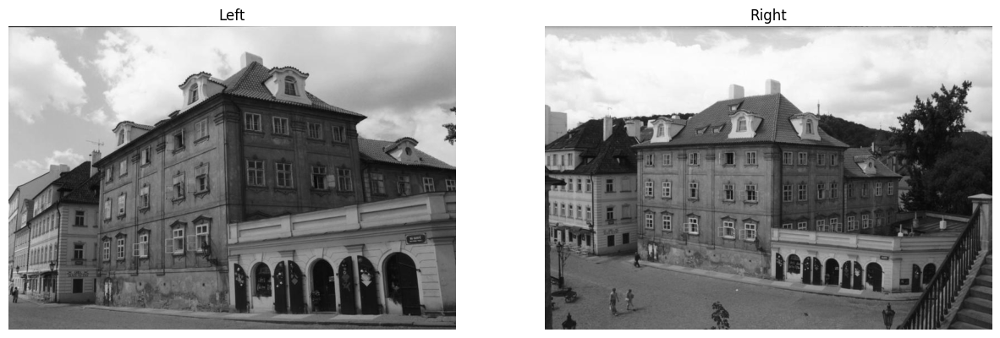

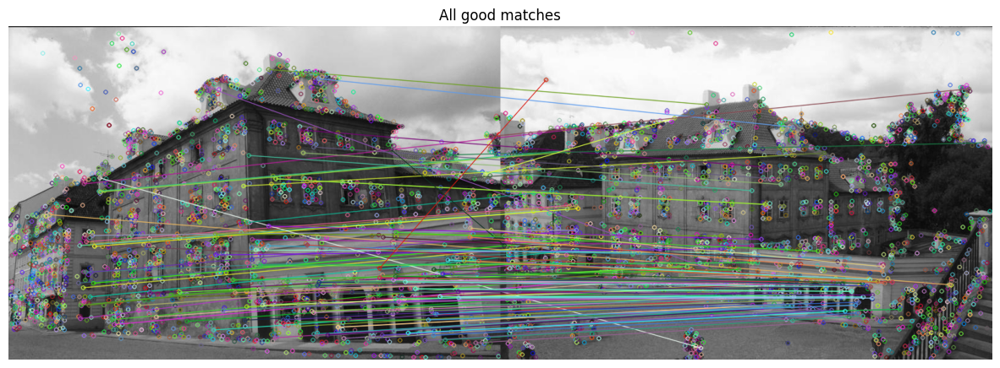


Number of good matches between two images:  136

Transform matrix:
[[   1.     0.  -400. ]
 [   0.     1.  -271.5]
 [   0.     0.     1. ]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[ 1.04737203e-05  7.86851146e-05 -3.09536019e-02]
 [-8.17207728e-05 -1.75411228e-05  3.10852218e-02]
 [ 4.66454826e-02 -4.31009675e-02  9.97016588e-01]]
Number of inliers: 94

F in terms of original pixel coordinates:
[[ 1.32058824e-05  6.36870358e-05 -5.17494155e-02]
 [-7.00010711e-05 -1.71766732e-05  6.34386806e-02]
 [ 5.87503701e-02 -6.35424322e-02 -1.93614891e+00]]
Number of inliers: 93


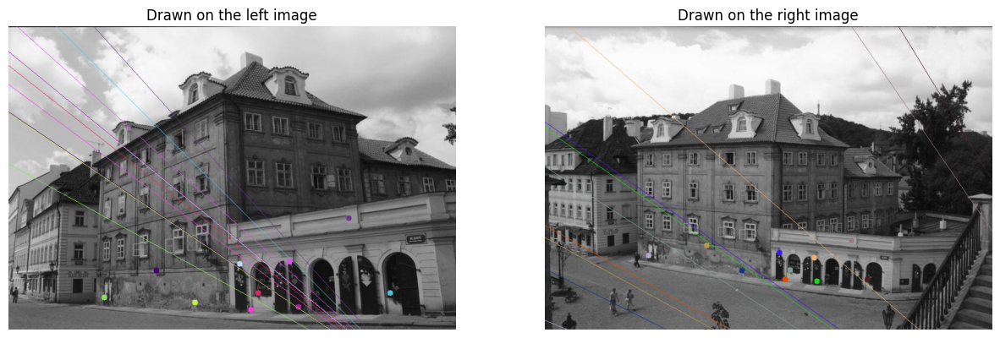





Image Pair 6


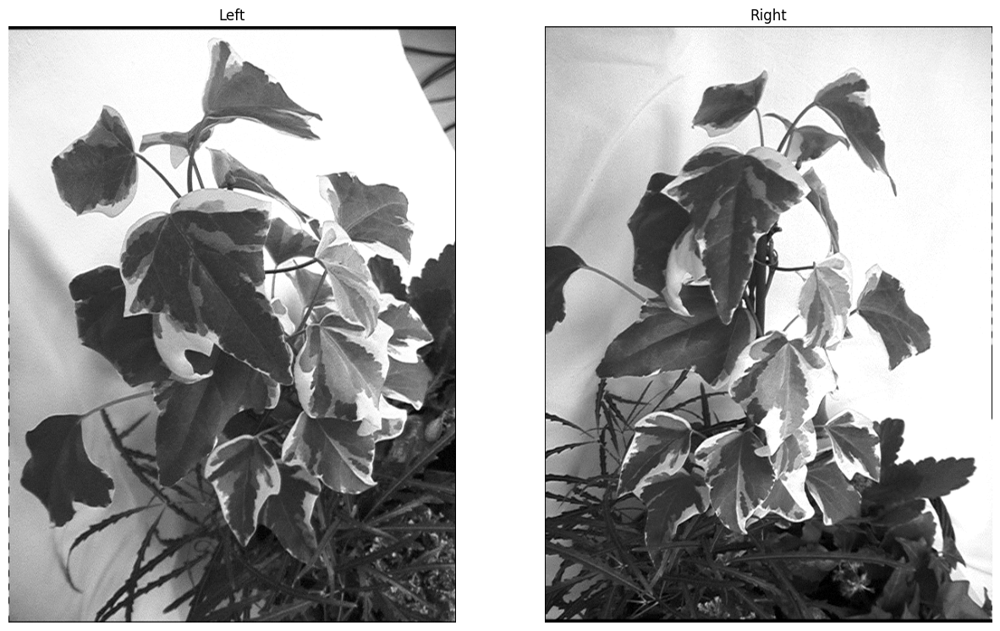

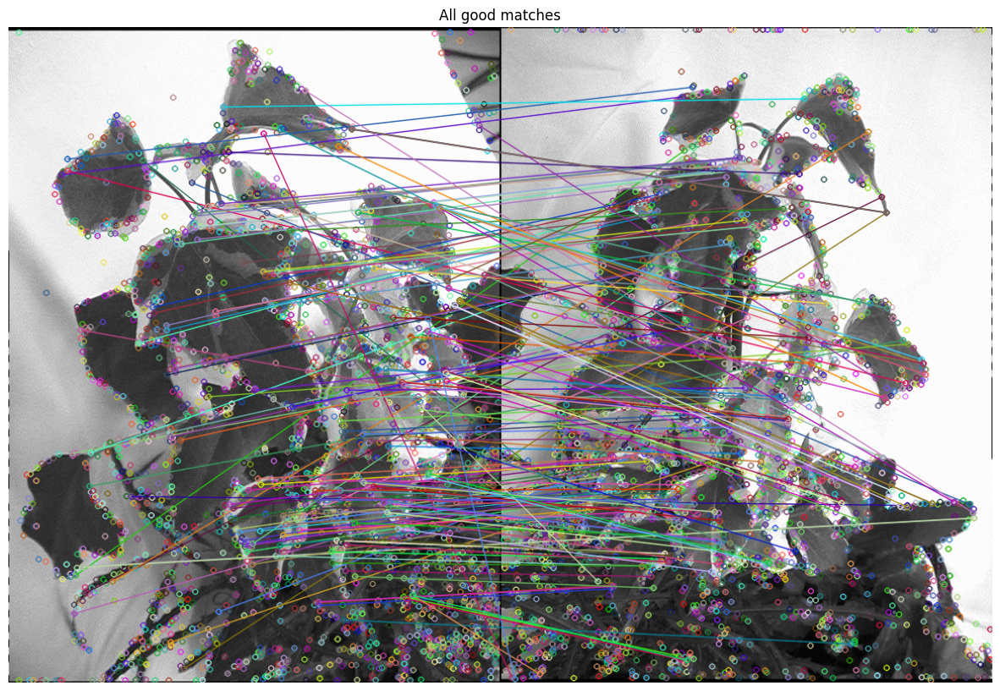


Number of good matches between two images:  176

Transform matrix:
[[   1.    0. -288.]
 [   0.    1. -384.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[ 1.28896691e-06 -4.62661894e-06 -1.40928405e-02]
 [ 7.73706793e-07  6.21173720e-06  2.12017498e-02]
 [ 2.81911771e-02 -7.47745285e-03  9.99250330e-01]]
Number of inliers: 114

F in terms of original pixel coordinates:
[[-1.45727292e-06  5.58865457e-06  1.19520311e-02]
 [-2.79343971e-06 -6.80961239e-06 -1.63987062e-02]
 [-2.52530248e-02  7.64604707e-03  7.00823898e+00]]
Number of inliers: 122


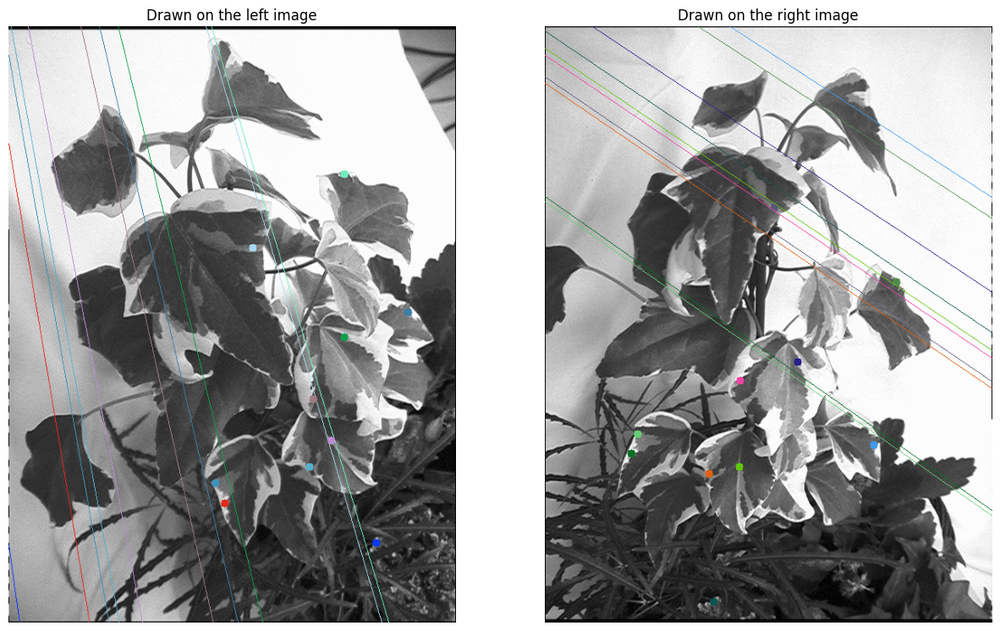





Image Pair 7


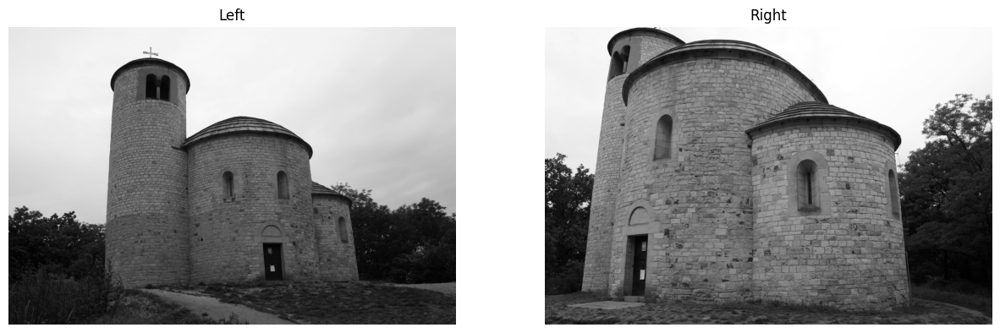

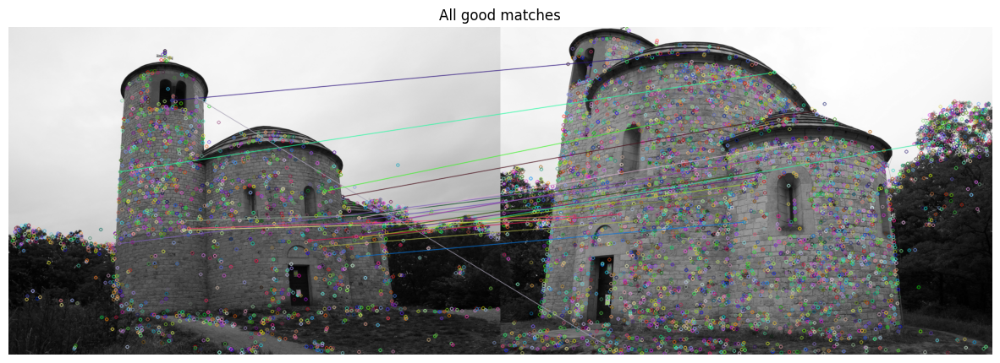


Number of good matches between two images:  22

Transform matrix:
[[   1.     0.  -512. ]
 [   0.     1.  -341.5]
 [   0.     0.     1. ]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-1.31395720e-06 -9.94944866e-06  9.03886608e-04]
 [-9.58024414e-07 -3.27534245e-07 -1.15161921e-02]
 [ 1.20844271e-03  8.10867013e-03  9.99899670e-01]]
Number of inliers: 16

F in terms of original pixel coordinates:
[[ 1.38930155e-06  1.03202010e-05 -5.09843477e-03]
 [ 8.64907446e-07 -2.65154621e-07  1.11026415e-02]
 [-2.23463645e-03 -1.33317839e-02  1.22691648e+00]]
Number of inliers: 16


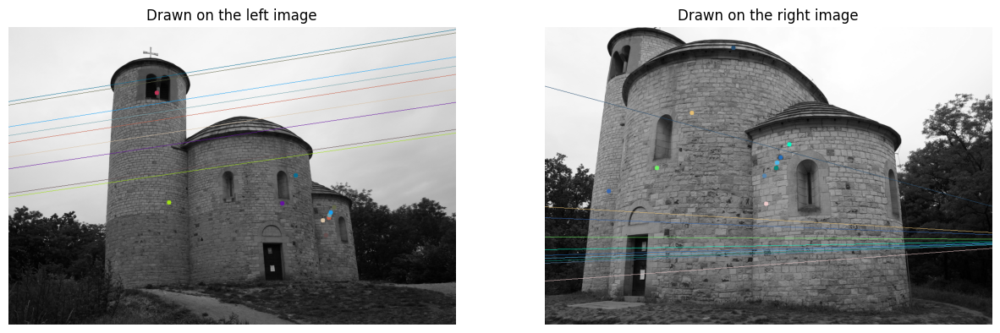





Image Pair 8


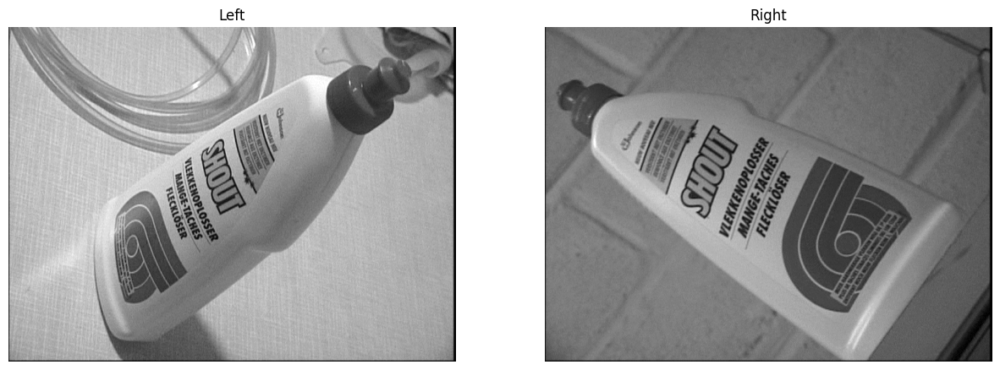

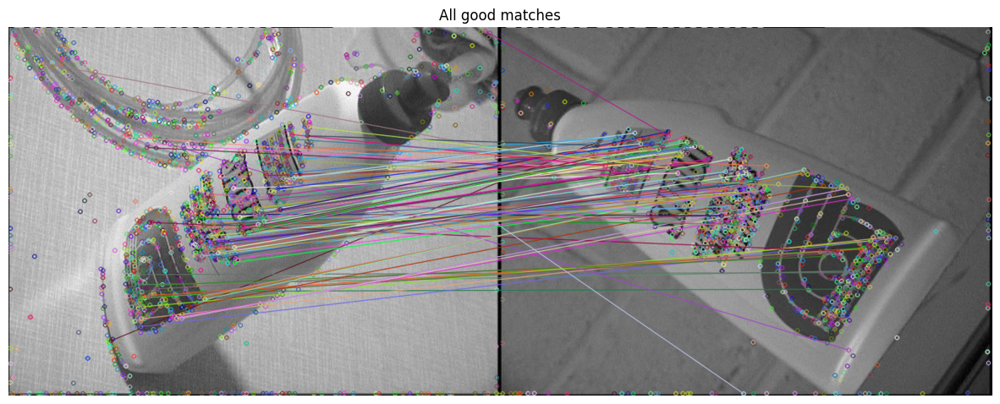


Number of good matches between two images:  110

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -288.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-1.53781655e-05  1.20051141e-05  2.02703040e-03]
 [-1.32416838e-05 -3.48246265e-05 -2.29169292e-02]
 [ 1.70327874e-02 -7.35510412e-03  9.99563150e-01]]
Number of inliers: 72

F in terms of original pixel coordinates:
[[-5.06321449e-05  3.76362529e-05  1.24971457e-02]
 [-2.70134383e-05 -5.89615827e-05  8.69877855e-03]
 [ 3.89155485e-02  1.07648427e-03 -1.03762765e+01]]
Number of inliers: 72


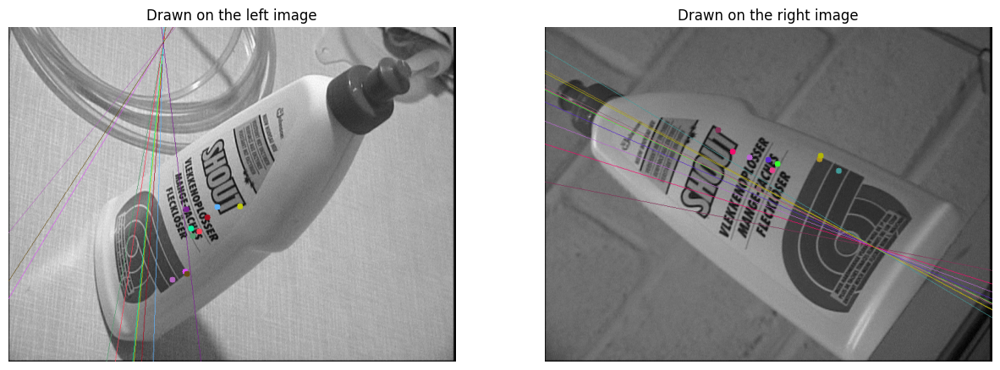





Image Pair 9


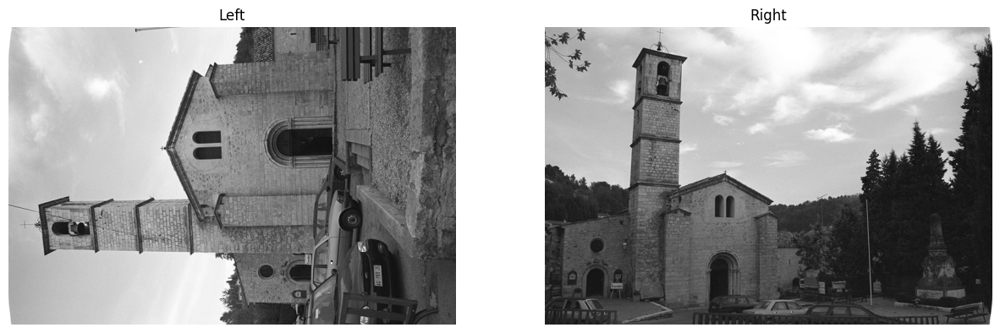

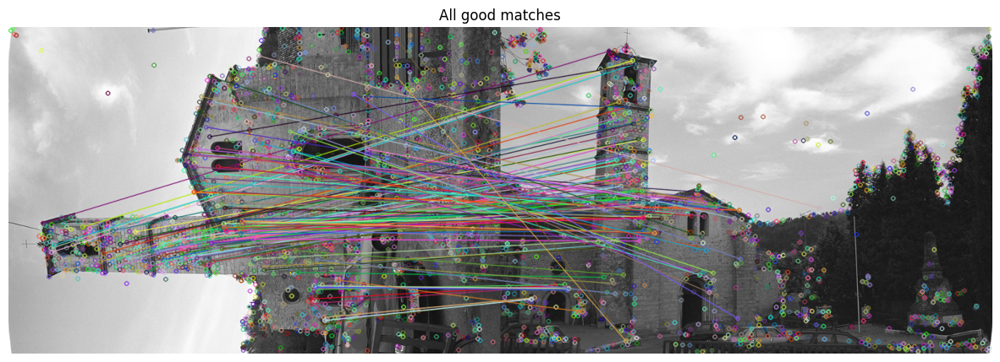


Number of good matches between two images:  137

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -256.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[-1.07322132e-05 -1.38611839e-06  5.94573848e-03]
 [-1.08558478e-06 -3.35138054e-06  1.39636854e-03]
 [ 2.26221001e-03 -8.80969534e-03  9.99939983e-01]]
Number of inliers: 123

F in terms of original pixel coordinates:
[[ 9.59058798e-06  1.25680952e-06 -1.03163693e-02]
 [ 1.01937884e-06  2.08631873e-06 -2.08605771e-03]
 [-6.00043179e-03  8.09982669e-03  1.95151387e+00]]
Number of inliers: 122


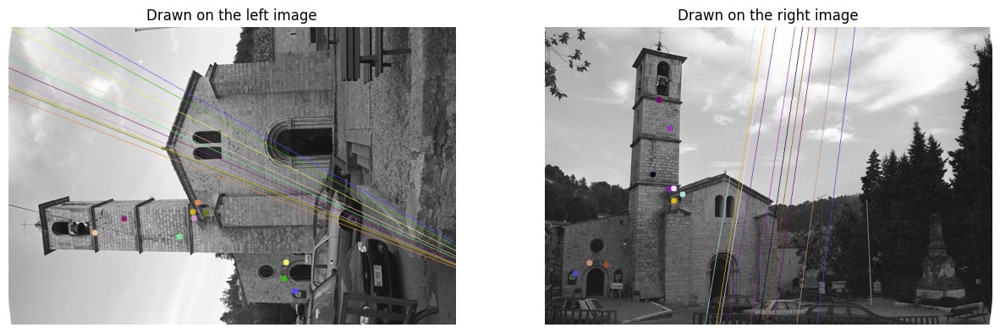





Image Pair 10


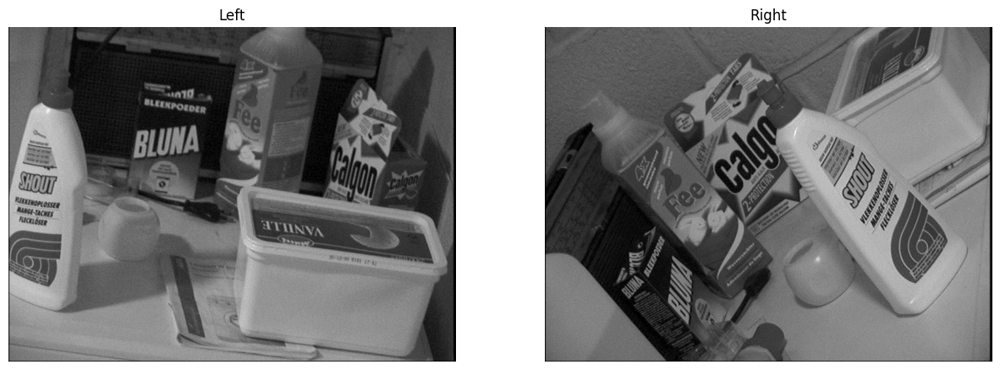

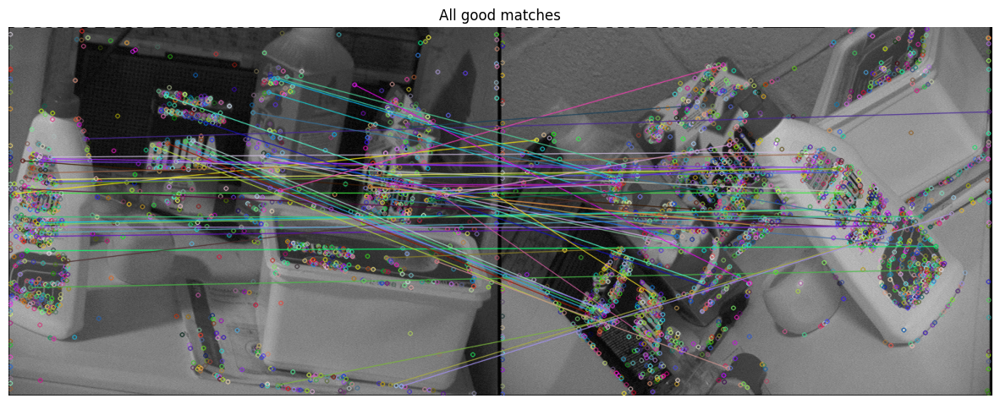


Number of good matches between two images:  61

Transform matrix:
[[   1.    0. -384.]
 [   0.    1. -288.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[ 1.64373094e-05 -7.78047953e-08 -2.71490775e-04]
 [ 1.28788413e-06  3.77016440e-07  4.89816599e-03]
 [-8.04373486e-04  8.06491362e-05  9.99987640e-01]]
Number of inliers: 12

F in terms of original pixel coordinates:
[[ 4.68091636e-06  3.31175577e-05 -1.36380296e-02]
 [-2.98633902e-05  3.04391141e-05  8.00536572e-03]
 [ 9.62188688e-03 -1.14992248e-02 -2.02635522e+00]]
Number of inliers: 11


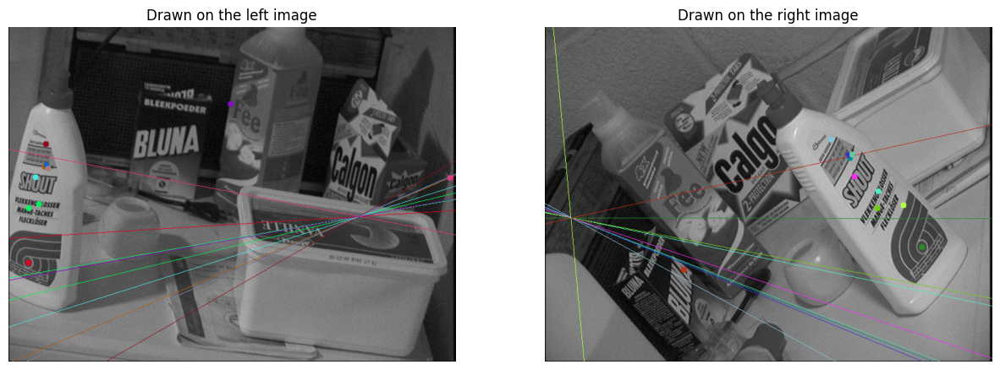





Image Pair 11


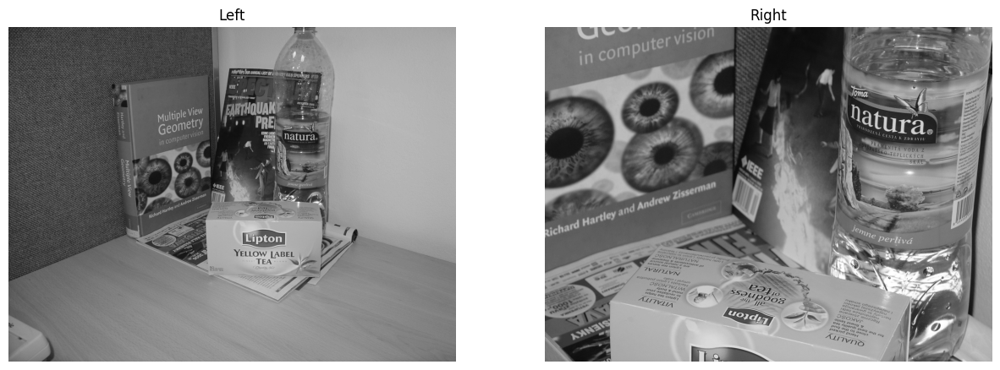

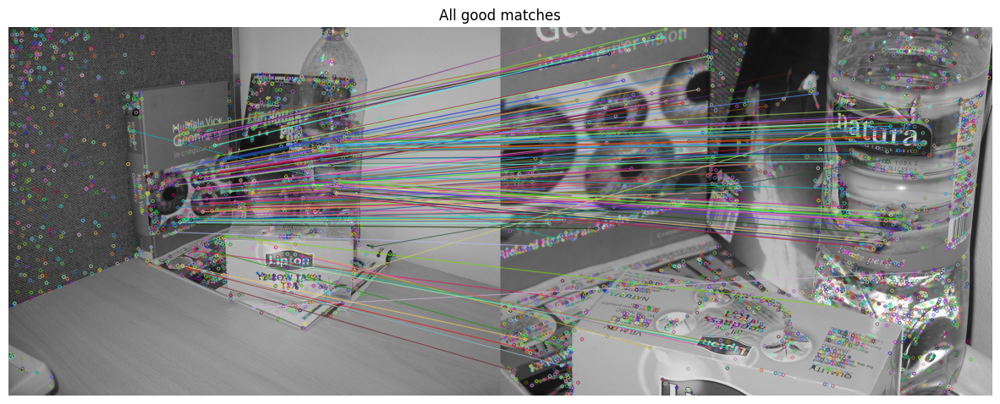


Number of good matches between two images:  180

Transform matrix:
[[   1.    0. -512.]
 [   0.    1. -384.]
 [   0.    0.    1.]]

Run at least 1177 times to have a probability over 99% of finding 8 inliers

Best F for shifted images:
[[ 1.13049863e-05 -1.97894790e-05  1.16728061e-01]
 [ 3.00455919e-05  8.79476204e-07  1.55473606e-01]
 [-3.59359096e-02 -6.56436303e-02  9.78060346e-01]]
Number of inliers: 116

F in terms of original pixel coordinates:
[[ 1.23604379e-05 -2.57335709e-05  1.13173027e-01]
 [ 3.49898041e-05 -5.22824979e-07  1.28398038e-01]
 [-5.32861603e-02 -4.82110703e-02 -6.54561696e+01]]
Number of inliers: 140


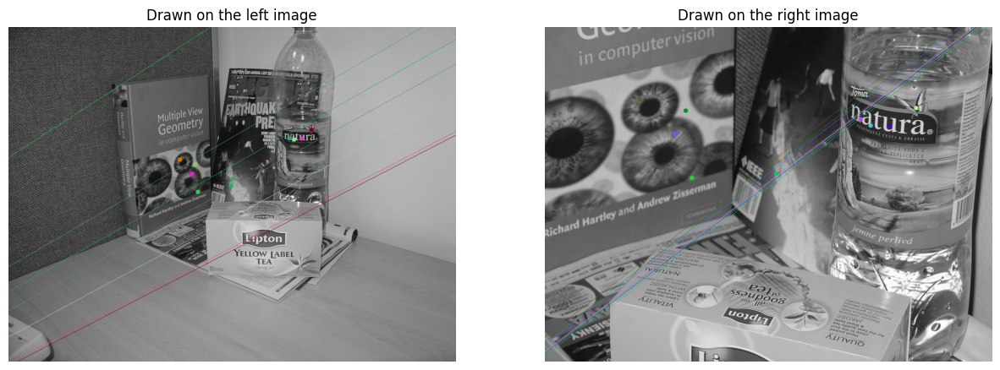

In [13]:
for i in range(len(left_images)):
    print(f"\n\n\n\nImage Pair {i}")
    display_all(left_images[i], right_images[i])

# End